# TensorFlow Workflow and Project Definition

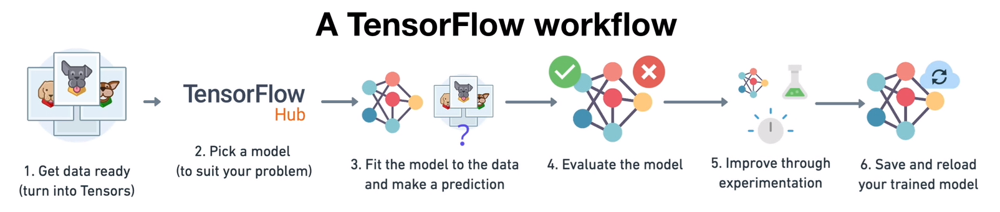

The goal of this project is to train a machine learning model that determines the breed of dogs.
* there are 120 breeds of dogs
* 10,000 images as training set (images have labels)
* 10,000 images as test set(images does not have labels)

[Download Dataset & Images](https://drive.google.com/drive/folders/1-FA9TZ0A2U7AEf4bhTD_xRyug-QBrHVM?usp=sharing)

# 0.Setting up the workspace


In [ ]:
from tensorflow._api.v2.config.experimental import list_physical_devices
#importing necessary tools
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
print("TF Version:", tf.__version__)
print("hub Version:", hub.__version__)
#checking for gpu availability
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available" )
print(tf.config.get_visible_devices)

TF Version: 2.12.0
hub Version: 0.14.0
GPU available
<function get_visible_devices at 0x7c71e6304040>


# 1.Getting our data ready (img to Tensor)



## Transformimg data into a  numerical format to allow the machine learning model to undrestand it.
Turning img to Tensors (numerical representation)

In [ ]:
# checking the labels
labels_csv = pd.read_csv("/content/drive/MyDrive/dogVision/labels.csv")
print(labels_csv.head())
print(labels_csv.describe())

                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever
                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126


<Axes: >

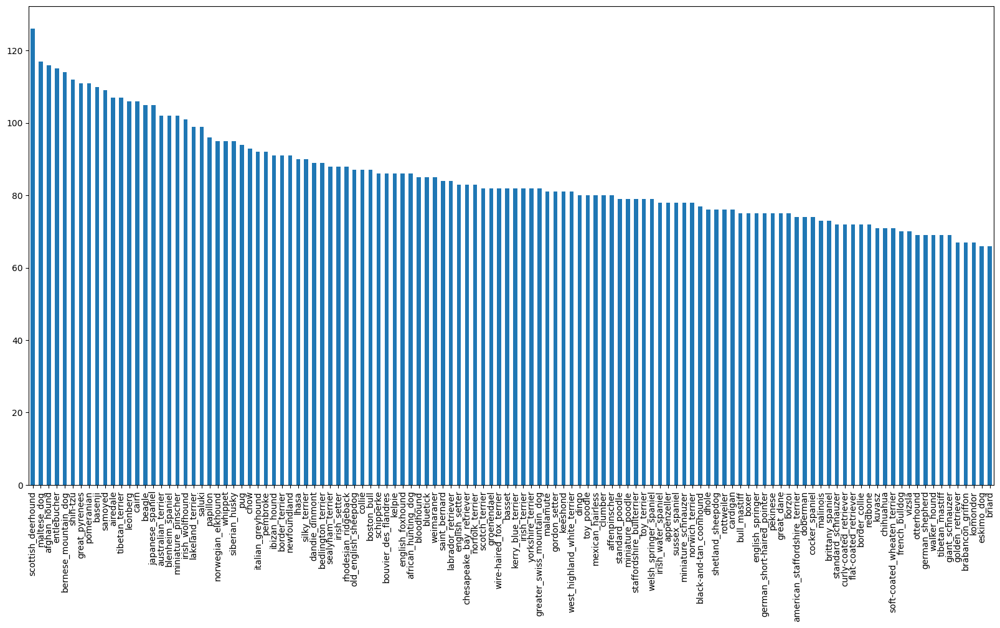

In [ ]:
#finding the number of each breed to see if there is a breed with a few training datas
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10))

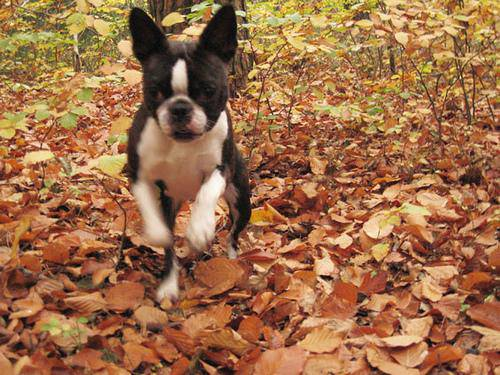

In [ ]:
from IPython.display import Image
Image("/content/drive/MyDrive/dogVision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

In [ ]:
#creating an array of file names
filenames =["/content/drive/MyDrive/dogVision/train/" + fname for fname in labels_csv["id"]+".jpg"]
filenames[:10]

['/content/drive/MyDrive/dogVision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/dogVision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/dogVision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/dogVision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/dogVision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/dogVision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/dogVision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/dogVision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/dogVision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/dogVision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
#making sure filenames has the same length as id
import os
print(len(os.listdir("/content/drive/MyDrive/dogVision/train/")))
print(len(filenames))

10222
10222


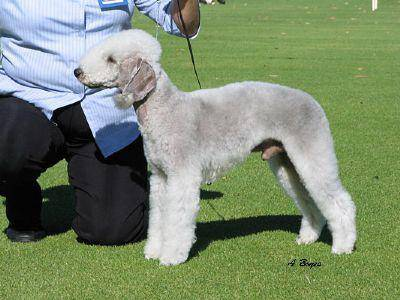

In [ ]:
Image(filenames[300])

In [ ]:
#sepperating labels and estimators
train_Y = labels_csv['breed'].to_numpy()
train_X = np.array(filenames)
if(len(train_Y)==len(train_X)) : print("test: positive")
len(train_X)

test: positive


10222

##Translating label(Y) into numbers

In [ ]:
# finding unique dog breeds
unique_breeds = np.unique(train_Y)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
# turning every label into boolean array
bool_train_Y = [index == unique_breeds for  index in train_Y]
print(len(bool_train_Y))
print(bool_train_Y[0])
#turning boolean arrray into intagers 1&0
int_train_Y = np.array(bool_train_Y).astype(int)
print(int_train_Y[0])

10222
[False False False False False False False False False False False False
 False False False False False False False  True False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


##Creating a validation set

In [ ]:
#setting a number of images apart as validation set
testVal_IMG = 8678 #@param{type: "slider", min:1000, max:10222, step:1 }

In [ ]:
#splitting data into training and validation sets
from sklearn.model_selection import train_test_split
X_train, X_val, Y_train, Y_val = train_test_split(train_X[:testVal_IMG], bool_train_Y[:testVal_IMG], test_size = 0.2, random_state=42)
X_test = train_X[testVal_IMG:]
Y_test = int_train_Y[testVal_IMG:]
print(len(X_train), len(X_val), len(X_test))
print(len(Y_train), len(Y_val), len(Y_test))

6942 1736 1544
6942 1736 1544


## preprocessing Images(img => Tensors)

1. Take img filepath as input
2. use tensorflow to read the file and save it into a variable ‘image’
3. turn ‘image’(jpg) to Tensor
4. resize ‘image’ to size (224,224)
5. return modified picture
---


In [ ]:
#converting img to numpy array
from matplotlib.pyplot import imread
image = imread(X_train[0])
print(image.shape)
image

(500, 333, 3)


array([[[255, 255, 251],
        [250, 251, 246],
        [247, 248, 243],
        ...,
        [229, 219, 253],
        [221, 212, 241],
        [252, 241, 255]],

       [[244, 245, 240],
        [238, 239, 234],
        [235, 236, 231],
        ...,
        [206, 196, 230],
        [199, 190, 219],
        [231, 221, 248]],

       [[239, 240, 235],
        [234, 235, 230],
        [233, 234, 229],
        ...,
        [211, 201, 235],
        [206, 197, 226],
        [238, 228, 255]],

       ...,

       [[ 66,  63,  70],
        [ 65,  62,  69],
        [ 51,  48,  55],
        ...,
        [223, 230, 179],
        [227, 233, 185],
        [234, 237, 192]],

       [[ 70,  67,  74],
        [ 62,  59,  66],
        [ 49,  46,  53],
        ...,
        [202, 209, 158],
        [209, 215, 167],
        [218, 221, 176]],

       [[ 78,  75,  82],
        [ 64,  61,  68],
        [ 52,  49,  56],
        ...,
        [242, 249, 198],
        [248, 254, 206],
        [255, 255, 214]]

In [ ]:
#turning img to a tensor
tf.constant(image)

<tf.Tensor: shape=(500, 333, 3), dtype=uint8, numpy=
array([[[255, 255, 251],
        [250, 251, 246],
        [247, 248, 243],
        ...,
        [229, 219, 253],
        [221, 212, 241],
        [252, 241, 255]],

       [[244, 245, 240],
        [238, 239, 234],
        [235, 236, 231],
        ...,
        [206, 196, 230],
        [199, 190, 219],
        [231, 221, 248]],

       [[239, 240, 235],
        [234, 235, 230],
        [233, 234, 229],
        ...,
        [211, 201, 235],
        [206, 197, 226],
        [238, 228, 255]],

       ...,

       [[ 66,  63,  70],
        [ 65,  62,  69],
        [ 51,  48,  55],
        ...,
        [223, 230, 179],
        [227, 233, 185],
        [234, 237, 192]],

       [[ 70,  67,  74],
        [ 62,  59,  66],
        [ 49,  46,  53],
        ...,
        [202, 209, 158],
        [209, 215, 167],
        [218, 221, 176]],

       [[ 78,  75,  82],
        [ 64,  61,  68],
        [ 52,  49,  56],
        ...,
        [242, 249, 19

In [ ]:
#now lets make a function to process tensor img

#define img size
IMG_SIZE = 224

def process_img(img_path):
  #reading the img
  image = tf.io.read_file(img_path)
  #turning the img into numerical Tensor with 3 colour rgb channels
  image = tf.image.decode_jpeg(image, channels=3)
  #converting the colour chanel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  #now we need to resize the img
  image = tf.image.resize(image, size=[IMG_SIZE,IMG_SIZE])
  return image


In [ ]:
process_img(X_train[0])

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[0.96564996, 0.96843225, 0.94996375],
        [0.9392985 , 0.9432201 , 0.92361224],
        [0.9511338 , 0.95505536, 0.9354475 ],
        ...,
        [0.77934474, 0.75189376, 0.8821546 ],
        [0.830729  , 0.79257256, 0.9206096 ],
        [0.90044725, 0.86515313, 0.95813257]],

       [[0.93899214, 0.9429137 , 0.92330587],
        [0.9208422 , 0.92476374, 0.9051559 ],
        [0.95088416, 0.95480573, 0.9351979 ],
        ...,
        [0.75144947, 0.7239984 , 0.85425925],
        [0.82199395, 0.78626543, 0.9070189 ],
        [0.89717394, 0.8618798 , 0.9696703 ]],

       [[0.9413495 , 0.9452711 , 0.92566323],
        [0.9267508 , 0.93067235, 0.9110645 ],
        [0.9536765 , 0.9575981 , 0.93799025],
        ...,
        [0.7946287 , 0.7663287 , 0.8991364 ],
        [0.87030125, 0.83500713, 0.9523387 ],
        [0.92991924, 0.8975926 , 0.98068875]],

       ...,

       [[0.25746113, 0.23785327, 0.25353956],
        [0.22

## turning the data into batches

its not memory wise to process 10,000 imgages at the same time, its better to process #batch-size images at a time.

we also need to make Tensor tuples to use TensorFlow more efficient.

In [ ]:
#creating tuple
def get_image_label(img_path, label):
  return(process_img(img_path), label)

In [ ]:
get_image_label(X_train[0], Y_train[0])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.96564996, 0.96843225, 0.94996375],
         [0.9392985 , 0.9432201 , 0.92361224],
         [0.9511338 , 0.95505536, 0.9354475 ],
         ...,
         [0.77934474, 0.75189376, 0.8821546 ],
         [0.830729  , 0.79257256, 0.9206096 ],
         [0.90044725, 0.86515313, 0.95813257]],
 
        [[0.93899214, 0.9429137 , 0.92330587],
         [0.9208422 , 0.92476374, 0.9051559 ],
         [0.95088416, 0.95480573, 0.9351979 ],
         ...,
         [0.75144947, 0.7239984 , 0.85425925],
         [0.82199395, 0.78626543, 0.9070189 ],
         [0.89717394, 0.8618798 , 0.9696703 ]],
 
        [[0.9413495 , 0.9452711 , 0.92566323],
         [0.9267508 , 0.93067235, 0.9110645 ],
         [0.9536765 , 0.9575981 , 0.93799025],
         ...,
         [0.7946287 , 0.7663287 , 0.8991364 ],
         [0.87030125, 0.83500713, 0.9523387 ],
         [0.92991924, 0.8975926 , 0.98068875]],
 
        ...,
 
        [[0.25746113, 0.23785327

In [ ]:
BATCH_SIZE = 32
#function to turn data into batches
def create_data_batches(X,Y=None, batch_size=BATCH_SIZE, valid_data = False, test_data=False):
  #if the data is a test data(we dont have labels)
  if test_data:
    print("creating test data batches.")
    data = tf.data.Dataset.from_tensor_slices(tf.constant(X))
    data_batch = data.map(process_img).batch(BATCH_SIZE)
    return data_batch
  #if the data is a validation data(we dont need to shuffle)
  elif valid_data:
    print("creating validation data batches.")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(Y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  #creating training data batch(need to shuffle)
  else:
    print("creating test data batches.")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(Y)))
    #shuffling parameters and labels
    data = data.shuffle(buffer_size = len(X))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

In [ ]:
#Creating training and validation data batches
train_data = create_data_batches(X_train, Y_train)
val_data = create_data_batches(X_val, Y_val, valid_data=True)



creating test data batches.
creating validation data batches.


In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## visualizing batches

In [ ]:
unique_breeds[Y_test[0].argmax()]

'japanese_spaniel'

In [ ]:
import matplotlib.pyplot as plt

def show_25_images(images, labels):
  #setting up the figure
  plt.figure(figsize=(20,20))
  #loop for 25
  for i in range(25):
    #creating subplots of 5 row and 5 col
    ax = plt.subplot(5, 5, i+1)
    #displaying img
    plt.imshow(images[i])
    #showing breed as title
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")

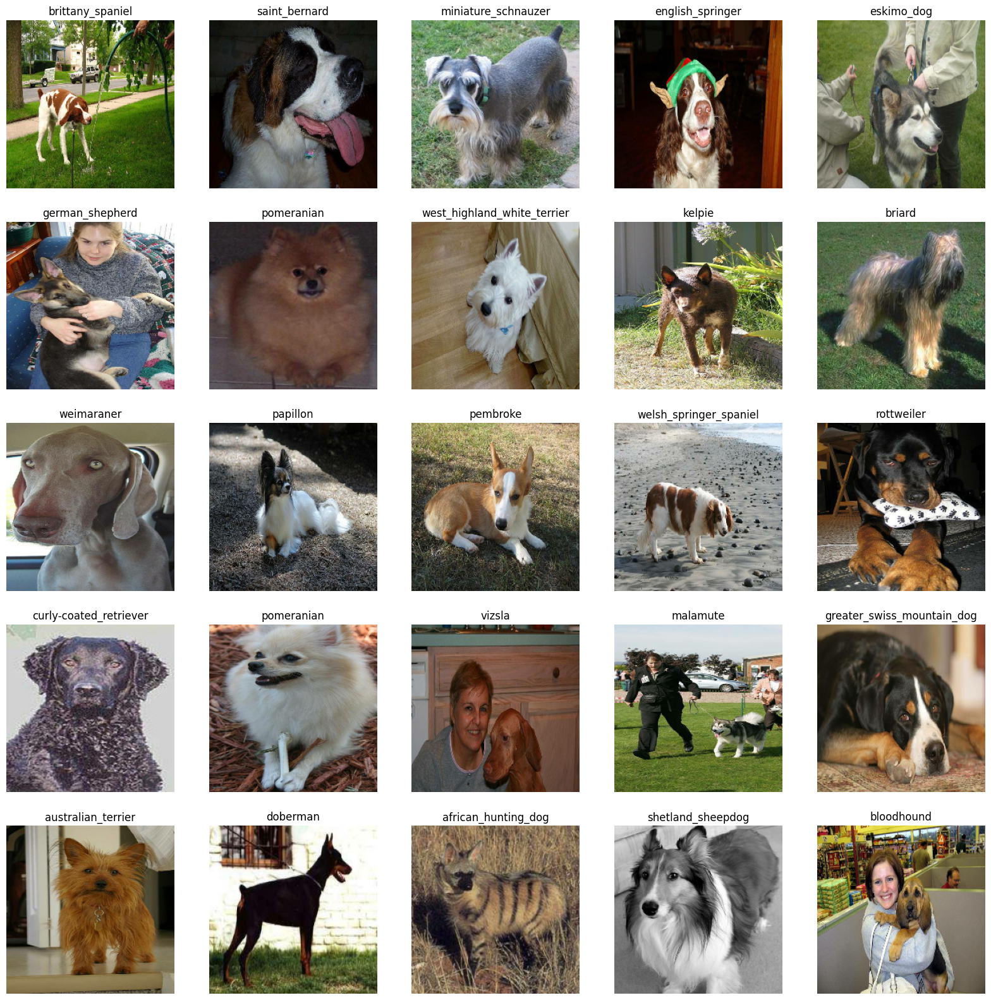

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
len(train_images), len(train_labels)
show_25_images(train_images,train_labels)

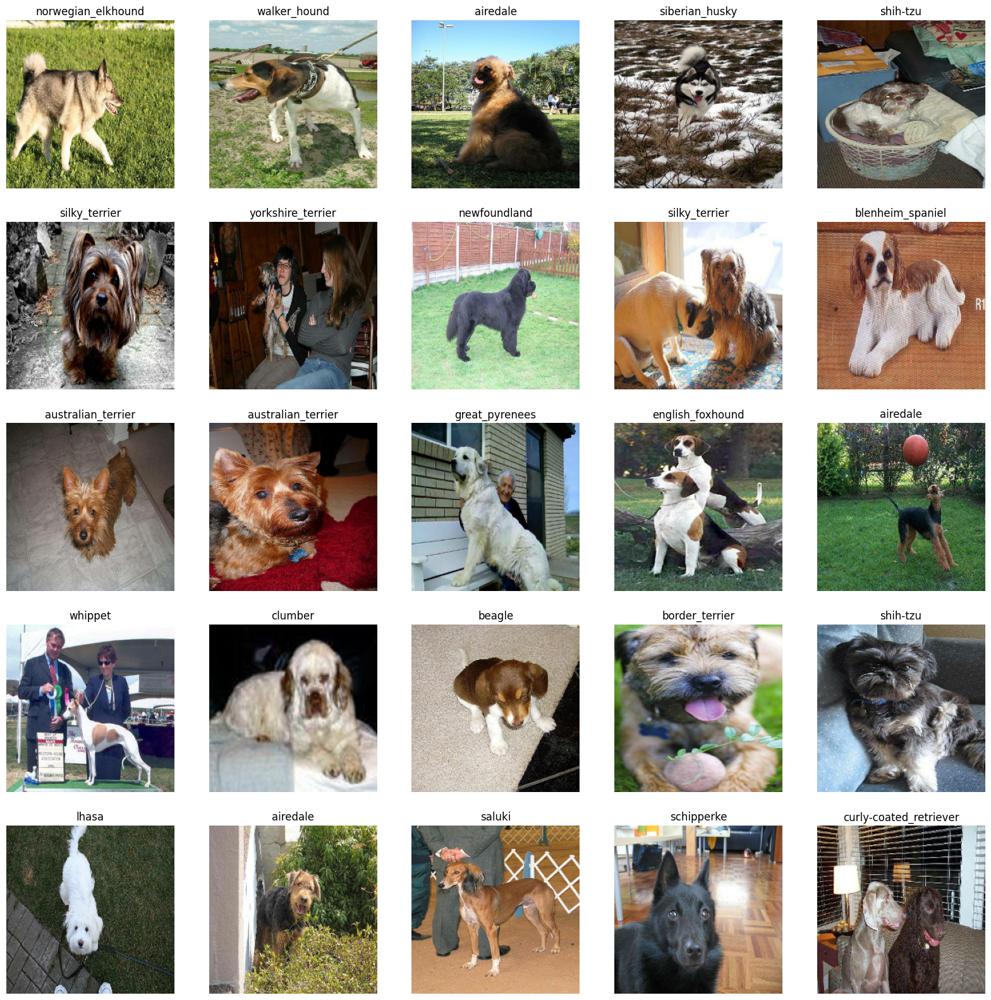

In [ ]:
val_images, val_labels = next(val_data.as_numpy_iterator())
len(val_images), len(val_labels)
show_25_images(val_images,val_labels)

# 2.Picking a model that suits our problem

* input shape in form of tensors
* output in form of tensors
* URL of the model we want to use

mobilenet_v2_130_224 Model uses Convolutional Neural Networks to classify the img :

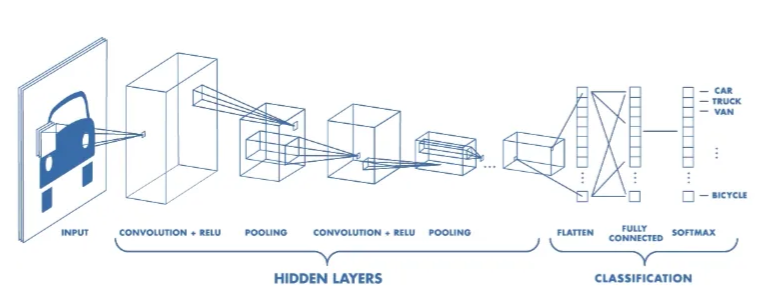

1. getting the input
2. performing transformations
3. transform until reaching the desired output

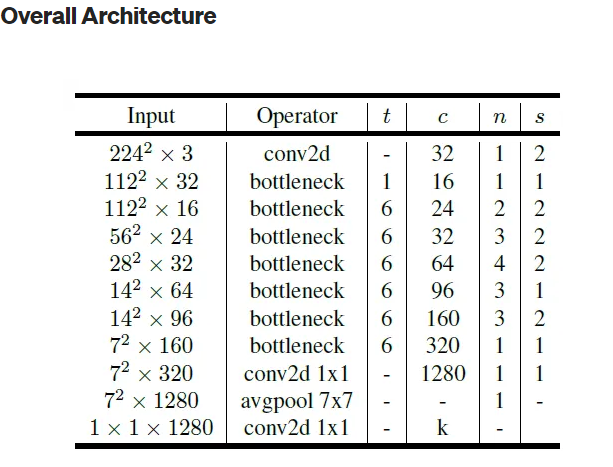


### picking amodel and writing a function to build the selected model


In [ ]:
# setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]
#setup the output shape of our model
OUTPUT_SHAPE = len(unique_breeds)
#Setup model's url from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

In [ ]:
#creating a function that build our model
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url= MODEL_URL):
  model = tf.keras.Sequential([hub.KerasLayer(MODEL_URL),
                               tf.keras.layers.Dense(units = output_shape,activation="softmax")
                               #after applying softmax function, each component will be in interval(1,0) and compinents add up to 1
                               #Binary Classification => activatio=sigmoid    loss = BinaryCrossentropy
                               #Multi-class Classification => activatio=softmax   loss = CategoricalCrossentropy
                               ])
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics = ["accuracy"]
  )
  model.build(input_shape)
  return model

In [ ]:
model = create_model()
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## CREATING CALLBACKS
callbacks help us to manage model while it is training.

* saving progress
* tracking progress and stop training early if its not improving (TensorBoard)


In [ ]:
# TensorBoard callback to save the progress
#Loading TensorBoard notebook extention
%load_ext tensorboard
import datetime
def create_tensorboard_callback():
  logdir = os.path.join("/content/drive/MyDrive/dogVision/logs",
                        datetime.datetime.now().strftime("%Y/%m/%d-%H/%M/%S/"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [ ]:
#creating early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

#3.Fitting the data to our model and train it

## training model on a few images to make sure things are working

1. create a model
2. setup TensorBorard callbacks
3. call the fit function to  pass the training data
4. return the model

In [ ]:
NUM_EPOCHS = 100 #@param{type: "slider", min: 10, max:100, step:10}


In [ ]:
#creating a function that creates a new model, a new tensorboard session, fits the training and validation dataset and returns the model
def train_model():
  #creating anew moel using the create_model function
  model = create_model()
  #creating new TensoBoard sessin with each model creation and training
  tensorboard = create_tensorboard_callback()
  #fitting the model with callbacks, training data and limited number of training data(epochs variable)
  model.fit(x=train_data,
            epochs = NUM_EPOCHS,
            validation_data = val_data,
            validation_freq = 1,
            callbacks = [tensorboard, early_stopping])
  #return the fitted model
  return model


overfitting: on the training data, loss goes down and accuracy goes up so model has learned the training data but the performance of validation data is not increasing as the val_accuracy is not increasing


loss: 0.0935 - accuracy: 1.0000 - val_loss: 1.2715 - val_accuracy: 0.6552
Epoch 7/100

loss: 0.0709 - accuracy: 1.0000 - val_loss: 1.2483 - val_accuracy: 0.6552
Epoch 8/

loss: 0.0559 - accuracy: 1.0000 - val_loss: 1.2303 - val_accuracy: 0.6601
Epoch 9/

loss: 0.0464 - accuracy: 1.0000 - val_loss: 1.2179 - val_accuracy: 0.6650
Epoch 10/

loss: 0.0389 - accuracy: 1.0000 - val_loss: 1.2062 - val_accuracy: 0.6650
Epoch 11/

loss: 0.0337 - accuracy: 1.0000 - val_loss: 1.1996 - val_accuracy: 0.6650
Epoch 12/

loss: 0.0294 - accuracy: 1.0000 - val_loss: 1.1991 - val_accuracy: 0.6650


In [ ]:
model = train_model()

Epoch 1/100
217/217 [==============================] - 125s 433ms/step - loss: 1.6155 - accuracy: 0.6193 - val_loss: 0.7986 - val_accuracy: 0.7690
Epoch 2/100
217/217 [==============================] - 12s 55ms/step - loss: 0.4153 - accuracy: 0.8868 - val_loss: 0.7593 - val_accuracy: 0.7730
Epoch 3/100
217/217 [==============================] - 12s 55ms/step - loss: 0.2309 - accuracy: 0.9430 - val_loss: 0.7380 - val_accuracy: 0.7800
Epoch 4/100
217/217 [==============================] - 12s 55ms/step - loss: 0.1436 - accuracy: 0.9723 - val_loss: 0.7397 - val_accuracy: 0.7719
Epoch 5/100
217/217 [==============================] - 12s 55ms/step - loss: 0.0969 - accuracy: 0.9860 - val_loss: 0.7524 - val_accuracy: 0.7811
Epoch 6/100
217/217 [==============================] - 12s 56ms/step - loss: 0.0692 - accuracy: 0.9918 - val_loss: 0.7497 - val_accuracy: 0.7811
Epoch 7/100
217/217 [==============================] - 12s 56ms/step - loss: 0.0506 - accuracy: 0.9963 - val_loss: 0.7727 - val_

# 4.Evaluating the trained model and visualizing the performance

## checking TensorBoard logs
the TensorBoard function will access the logs directory and visualize it's content

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/dogVision/logs

<IPython.core.display.Javascript object>

## evaluating predictions using the trained model

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
#making predictions
predictions = model.predict(val_data, verbose =1)

55/55 [==============================] - 3s 43ms/step


In [ ]:
#each index is a probability value and the highest is the model's final answer
predictions[1]

array([4.5180254e-08, 3.5446902e-08, 1.9133104e-09, 3.2706441e-07,
       1.6674599e-04, 1.3705316e-07, 1.1503480e-06, 8.8986799e-06,
       1.9348186e-06, 1.5868848e-03, 1.2822698e-08, 8.3644397e-10,
       4.7357690e-07, 1.0141731e-08, 8.1610642e-07, 1.8148808e-03,
       1.2508597e-05, 3.7786631e-07, 3.4437965e-06, 8.0796090e-06,
       9.1328964e-08, 1.6752421e-05, 2.9431758e-06, 4.6751663e-07,
       1.7912945e-06, 5.2859292e-07, 1.0018956e-07, 1.1077528e-06,
       8.5929585e-08, 1.9181046e-07, 7.6159019e-08, 1.2927328e-09,
       2.7266231e-09, 9.6633048e-06, 1.6026920e-08, 9.1294837e-08,
       5.2162036e-10, 7.5128855e-07, 1.5067556e-05, 8.9395035e-05,
       1.5845083e-06, 2.1524058e-05, 6.1330105e-08, 9.4457170e-07,
       1.6887459e-08, 1.7734611e-07, 1.5403866e-05, 2.5245261e-06,
       6.4410230e-08, 1.0353127e-08, 9.8633768e-09, 1.0097498e-05,
       2.1290678e-06, 1.9330203e-06, 1.2396916e-07, 4.9403316e-06,
       7.5163996e-08, 8.5296499e-08, 3.0547874e-08, 3.8859957e

In [ ]:
index = 1 # @param {type:"slider", min:0, max:100, step:1}

print(predictions.shape)
#softmax definition states that sum of indexex is 1
print(f"sum of all indexes: {np.sum(predictions[index])}")
#finding index with highest probability value
print(f"maximum value(probabilty) {np.max(predictions[index])}")
print(f"index which the maximum accurs: {np.argmax(predictions[index])}")
print(f"name of the breen of the maximum index: {unique_breeds[predictions[index].argmax()]}")

(1736, 120)
sum of all indexes: 1.0000001192092896
maximum value(probabilty) 0.9680965542793274
index which the maximum accurs: 113
name of the breen of the maximum index: walker_hound


In [ ]:
#creating a function that returnes the prediction in the form of name
def get_pred_label(prediction_probabilities):
  return unique_breeds[np.argmax(prediction_probabilities)]

In [ ]:
get_pred_label(predictions[1])

'walker_hound'

## unbatching img and labels

In [ ]:
# unbatching the dataset
def unbatchify(data):
  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

In [ ]:
# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.9409415 , 0.8732157 , 0.7800522 ],
         [0.93633103, 0.86860526, 0.7754417 ],
         [0.93188244, 0.8680782 , 0.76611733],
         ...,
         [0.5619355 , 0.6511862 , 0.13282539],
         [0.52170676, 0.60029644, 0.21341434],
         [0.28226167, 0.35405394, 0.01031617]],
 
        [[0.99290097, 0.9541142 , 0.8639181 ],
         [0.9918418 , 0.953055  , 0.86285895],
         [0.9878351 , 0.9501075 , 0.8567339 ],
         ...,
         [0.58764297, 0.66876656, 0.17611055],
         [0.5261392 , 0.58770573, 0.22967364],
         [0.35774112, 0.41315883, 0.09862647]],
 
        [[0.9803922 , 0.9815652 , 0.90006137],
         [0.9803922 , 0.9815652 , 0.90006137],
         [0.9803922 , 0.9815652 , 0.90006137],
         ...,
         [0.5280783 , 0.6004384 , 0.16100374],
         [0.514968  , 0.55671966, 0.2517592 ],
         [0.38672587, 0.4225452 , 0.15345378]],
 
        ...,
 
        [[0.47600585, 0.5195351 , 0.23987216],
         [0.5029558 , 0.5465594 , 0.24182

## visualizing the evaluations

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change plot title to be predicted, probability of prediction and truth label
  plt.title("{}   {:2.0f}%    {}".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)

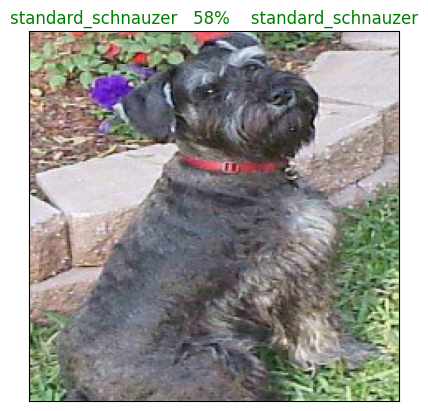

In [ ]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=190)

In [ ]:
# This function is for ploting the top predictions
def plot_pred_conf(prediction_probabilities, labels, n=0):

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find top prediction confidence indexes
  pred_indexes = pred_prob.argsort()[-5:][::-1]
  # Find the top predictions confidence values
  pred_values = pred_prob[pred_indexes]
  # Find the top prediction labels
  pred_labels = unique_breeds[pred_indexes]
  # Setup plot
  top_plot = plt.bar(np.arange(len(pred_labels)),
                     pred_values,
                     color="grey")
  plt.xticks(np.arange(len(pred_labels)),
             labels=pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, pred_labels):
    top_plot[np.argmax(pred_labels == true_label)].set_color("green")
  else:
    pass

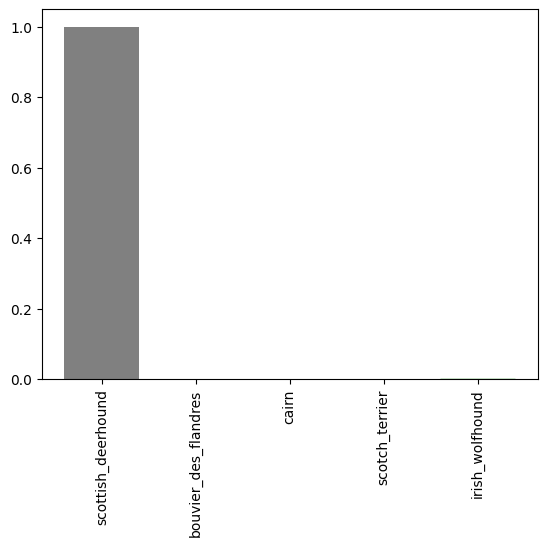

In [ ]:
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=90)

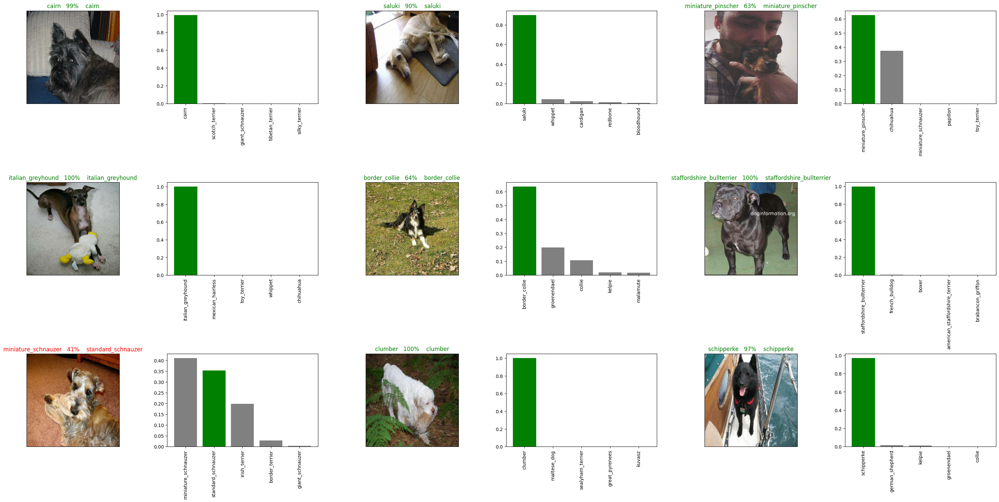

In [ ]:
# Cheking the predictions and their different values
i_multiplier = 30
num_rows = 3
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

# 5.Improving the model

In [ ]:
#now we can improve the model by training it on all data
labels_csv = pd.read_csv("/content/drive/MyDrive/dogVision/labels.csv")
filenames = ["/content/drive/MyDrive/dogVision/train/" + fname for fname in labels_csv["id"]+".jpg"]
#sepperating labels and estimators
train_Y_full = labels_csv['breed'].to_numpy()
bool_train_Y_full = [index == unique_breeds for  index in train_Y_full]
train_X_full = np.array(filenames)
#creating batches of full data
full_data = create_data_batches(train_X_full, bool_train_Y_full)
full_data


creating test data batches.


<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
len(train_X_full), len(bool_train_Y_full)

(10222, 10222)

In [ ]:
full_model = create_model()
#creating callbacks
full_model_tensorboard = create_tensorboard_callback()
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience= 5)
#fitting the data
full_model.fit(x=full_data,
              epochs = NUM_EPOCHS,
              callbacks = [full_model_tensorboard,full_model_early_stopping ])

Epoch 1/100
320/320 [==============================] - 19s 48ms/step - loss: 1.3607 - accuracy: 0.6662
Epoch 2/100
320/320 [==============================] - 15s 46ms/step - loss: 0.4066 - accuracy: 0.8769
Epoch 3/100
320/320 [==============================] - 15s 45ms/step - loss: 0.2401 - accuracy: 0.9327
Epoch 4/100
320/320 [==============================] - 14s 45ms/step - loss: 0.1556 - accuracy: 0.9630
Epoch 5/100
320/320 [==============================] - 14s 45ms/step - loss: 0.1062 - accuracy: 0.9798
Epoch 6/100
320/320 [==============================] - 15s 45ms/step - loss: 0.0765 - accuracy: 0.9866
Epoch 7/100
320/320 [==============================] - 14s 45ms/step - loss: 0.0595 - accuracy: 0.9907
Epoch 8/100
320/320 [==============================] - 15s 45ms/step - loss: 0.0465 - accuracy: 0.9937
Epoch 9/100
320/320 [==============================] - 15s 46ms/step - loss: 0.0372 - accuracy: 0.9962
Epoch 10/100
320/320 [==============================] - 15s 45ms/step - l

# 6.Saving and loading the model

In [ ]:
def save_model(model, suffix=None):

  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/dogVision/models", datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%s"))
  model_path = modeldir + "-" + suffix + ".h5"
  model.save(model_path)
  return model_path

In [ ]:
def load_model(model_path):
  print(f"Loading the saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Saving our model
save_model(model, suffix="8000-images")
save_model(full_model, suffix="full-img")

'/content/drive/MyDrive/dogVision/models/2023-08-29_05-22-1693286541-full-img.h5'

In [ ]:
#loading the model
loaded_model = load_model("/content/drive/MyDrive/dogVision/models/2023-08-28_23-48-1693266513-8000-images.h5")
loaded_model_full = load_model("/content/drive/MyDrive/dogVision/models/2023-08-29_05-22-1693286541-full-img.h5")

Loading the saved model from: /content/drive/MyDrive/dogVision/models/2023-08-28_23-48-1693266513-8000-images.h5
Loading the saved model from: /content/drive/MyDrive/dogVision/models/2023-08-29_05-22-1693286541-full-img.h5


In [ ]:
#testing the loaded model
loaded_model.evaluate(val_data)
loaded_model_full.evaluate(val_data)

55/55 [==============================] - 3s 43ms/step - loss: 0.0093 - accuracy: 0.9988


[0.00928131490945816, 0.9988479018211365]